In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

from sklearn.datasets import load_iris
from matplotlib import rc

In [2]:
iris = load_iris()
X = iris.data
Y = iris.target

In [3]:
f1 = 0
f2 = 1

X = X[Y<2,f1:f2+1]
Y = Y[Y<2]

In [4]:
Y=np.array([-1 if i==0 else 1 for i in Y])

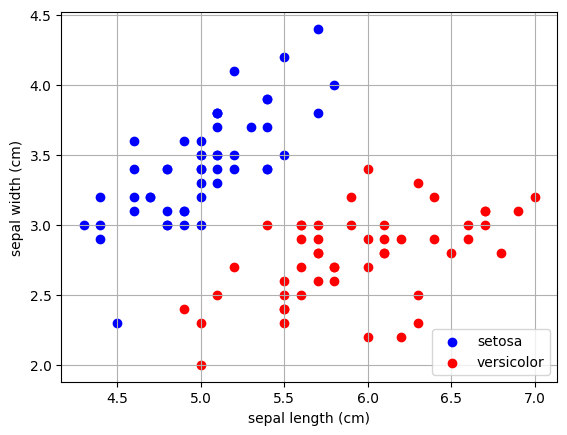

In [5]:
fig, ax = plt.subplots()

line, = ax.plot([], [], 'k-')

ax.scatter(X[Y==-1, 0], X[Y==-1, 1], c='b', label=iris.target_names[0])
ax.scatter(X[Y==1, 0], X[Y==1, 1], c='r', label=iris.target_names[1])
ax.legend(loc='lower right')

ax.set_xlabel(iris.feature_names[f1])
#ax.set_xlim(0, 6)
ax.set_ylabel(iris.feature_names[f2])
#ax.set_ylim(0, 2)

x = np.linspace(ax.get_xlim()[0], ax.get_xlim()[1], 2)

ax.grid(True)

In [6]:
def perceptron(X,Y,T):
    theta= np.zeros(len(X[0]))
    lista_thetas=[]
    theta_0 = 0

    for t in range(T):
        for obs,res in zip(X,Y):
            if(np.dot(res,(np.dot(theta,obs)+theta_0))<=0):
                theta=theta+np.dot(res,obs) 
                theta_0=theta_0+res
                lista_thetas.append((theta_0,theta))

    
    return(lista_thetas)



In [7]:
lista_thetas=perceptron(X,Y,200)

In [8]:
def anima(i):

    y=np.zeros(len(x))
    cont=0
    for val in x:
        y[cont]=-(lista_thetas[i][1][0]*val + lista_thetas[i][0])/(lista_thetas[i][1][1])
        cont=cont+1

    line.set_data(x, y)
    return line,

animacion = animation.FuncAnimation(fig, anima, frames=len(lista_thetas), interval=100, blit=True)

In [9]:
rc('animation', html='jshtml')
animacion